In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing
import matplotlib.pyplot as plt # visualization
import seaborn as sns # visualization
import plotly.graph_objects as go
from scipy import stats
from scipy.stats import norm 
from sklearn.pipeline import Pipeline
from sklearn import svm
from sklearn.neighbors import KNeighborsRegressor
import xgboost 
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.linear_model import LinearRegression
from sklearn import svm
from sklearn.metrics import mean_absolute_error, make_scorer
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, cross_validate, ShuffleSplit, LeaveOneOut
from sklearn.metrics import confusion_matrix
from sklearn.externals.joblib import Parallel, parallel_backend
from sklearn.metrics import classification_report
from sklearn.preprocessing import StandardScaler
import dask_ml.datasets
import dask_ml.cluster
from distributed import Executor
from joblib import Parallel, parallel_backend
from scipy.stats import zscore
from sklearn.preprocessing import QuantileTransformer
import warnings 
warnings.filterwarnings('ignore') #ignore warnings

%matplotlib inline
import gc
import time

/usr/local/anaconda3/lib/python3.7/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning:

sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.



In [2]:
# Imports in order to be able to use Plotly offline.
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.graph_objs as go
import chart_studio.plotly as py
import cufflinks as cf
from plotly.tools import FigureFactory as FF
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

print(__version__) # requires version >= 1.9.0

init_notebook_mode(connected=True)

4.3.0


In [3]:
from dask.distributed import Client

client = Client()
client

Client Scheduler: tcp://127.0.0.1:54132 Dashboard: http://127.0.0.1:8787/status,Cluster Workers: 4 Cores: 4 Memory: 8.59 GB


In [4]:
pd.set_option('display.max_columns', 500)

In [5]:
train = pd.read_csv('/Users/yashpasar/Downloads/walmart-recruiting-store-sales-forecasting/train.csv')
test = pd.read_csv('/Users/yashpasar/Downloads/walmart-recruiting-store-sales-forecasting/test.csv')
stores = pd.read_csv('/Users/yashpasar/Downloads/walmart-recruiting-store-sales-forecasting/stores.csv')
features = pd.read_csv('/Users/yashpasar/Downloads/walmart-recruiting-store-sales-forecasting/features.csv')

In [6]:
train.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday
0,1,1,2010-02-05,24924.50,False
1,1,1,2010-02-12,46039.49,True
2,1,1,2010-02-19,41595.55,False
3,1,1,2010-02-26,19403.54,False
4,1,1,2010-03-05,21827.90,False


In [7]:
stores.head()

,Store,Type,Size
0,1,A,151315
1,2,A,202307
2,3,B,37392
3,4,A,205863
4,5,B,34875


In [8]:
features.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False
3,1,2010-02-26,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False
4,1,2010-03-05,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False


In [9]:
df = train.merge(stores, how='left').merge(features, how='left')

In [10]:
df.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
0,1,1,2010-02-05,24924.50,False,A,151315,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106
1,1,1,2010-02-12,46039.49,True,A,151315,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106
2,1,1,2010-02-19,41595.55,False,A,151315,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106
3,1,1,2010-02-26,19403.54,False,A,151315,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106
4,1,1,2010-03-05,21827.90,False,A,151315,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106


In [11]:
df.shape

(421570, 16)

In [12]:
df['IsHoliday'].value_counts()

False    391909
True      29661
Name: IsHoliday, dtype: int64

In [13]:
df_true = df[df['IsHoliday']== True]
df = df[df['IsHoliday']== False]

In [14]:
df = df.sample(frac=0.15, replace=True, random_state=1)
df = df.append(df_true)

In [15]:
df.shape

(88447, 16)

In [16]:
df['IsHoliday'].value_counts()

False    58786
True     29661
Name: IsHoliday, dtype: int64

In [17]:
df = df.reset_index()

In [18]:
df.head()

,index,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
0,137746,14,95,2012-03-23,129326.88,False,A,200898,59.45,3.900,4718.70,348.81,6.85,353.11,3726.39,190.536321,8.424
1,287603,30,8,2011-06-10,11198.38,False,C,42988,84.71,3.648,NaN,NaN,NaN,NaN,NaN,214.696491,7.931
2,335849,35,40,2011-10-28,31195.27,False,B,103681,51.81,3.569,NaN,NaN,NaN,NaN,NaN,140.444790,8.745
3,399519,43,12,2010-06-18,113.56,False,C,41062,84.90,2.637,NaN,NaN,NaN,NaN,NaN,203.370619,9.593
4,78921,9,2,2012-06-01,28086.88,False,B,125833,80.26,3.501,2542.14,35.60,76.80,374.37,3413.57,225.494608,5.539


In [19]:
df.drop(['index'], axis=1,inplace=True)
df.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
0,14,95,2012-03-23,129326.88,False,A,200898,59.45,3.900,4718.70,348.81,6.85,353.11,3726.39,190.536321,8.424
1,30,8,2011-06-10,11198.38,False,C,42988,84.71,3.648,NaN,NaN,NaN,NaN,NaN,214.696491,7.931
2,35,40,2011-10-28,31195.27,False,B,103681,51.81,3.569,NaN,NaN,NaN,NaN,NaN,140.444790,8.745
3,43,12,2010-06-18,113.56,False,C,41062,84.90,2.637,NaN,NaN,NaN,NaN,NaN,203.370619,9.593
4,9,2,2012-06-01,28086.88,False,B,125833,80.26,3.501,2542.14,35.60,76.80,374.37,3413.57,225.494608,5.539


# Exploratory Data Analysis & Feature Engineering

In [20]:
print('Columns with null values:' ,sum(list(df.isnull().any())))

Columns with null values: 5


In [21]:
df.isnull().any()

Store           False
Dept            False
Date            False
Weekly_Sales    False
IsHoliday       False
Type            False
Size            False
Temperature     False
Fuel_Price      False
MarkDown1        True
MarkDown2        True
MarkDown3        True
MarkDown4        True
MarkDown5        True
CPI             False
Unemployment    False
dtype: bool

In [22]:
#Replace null values with 0
df.fillna(0,inplace=True)

In [23]:
df.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
0,14,95,2012-03-23,129326.88,False,A,200898,59.45,3.900,4718.70,348.81,6.85,353.11,3726.39,190.536321,8.424
1,30,8,2011-06-10,11198.38,False,C,42988,84.71,3.648,0.00,0.00,0.00,0.00,0.00,214.696491,7.931
2,35,40,2011-10-28,31195.27,False,B,103681,51.81,3.569,0.00,0.00,0.00,0.00,0.00,140.444790,8.745
3,43,12,2010-06-18,113.56,False,C,41062,84.90,2.637,0.00,0.00,0.00,0.00,0.00,203.370619,9.593
4,9,2,2012-06-01,28086.88,False,B,125833,80.26,3.501,2542.14,35.60,76.80,374.37,3413.57,225.494608,5.539


In [24]:
df.Date = pd.to_datetime(df.Date)

In [25]:
df['Year'] = df.Date.dt.year
df['Month'] = df.Date.dt.month
df['Week'] = df.Date.dt.week
df['Day'] = df.Date.dt.day

In [26]:
df.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Year,Month,Week,Day
0,14,95,2012-03-23,129326.88,False,A,200898,59.45,3.900,4718.70,348.81,6.85,353.11,3726.39,190.536321,8.424,2012,3,12,23
1,30,8,2011-06-10,11198.38,False,C,42988,84.71,3.648,0.00,0.00,0.00,0.00,0.00,214.696491,7.931,2011,6,23,10
2,35,40,2011-10-28,31195.27,False,B,103681,51.81,3.569,0.00,0.00,0.00,0.00,0.00,140.444790,8.745,2011,10,43,28
3,43,12,2010-06-18,113.56,False,C,41062,84.90,2.637,0.00,0.00,0.00,0.00,0.00,203.370619,9.593,2010,6,24,18
4,9,2,2012-06-01,28086.88,False,B,125833,80.26,3.501,2542.14,35.60,76.80,374.37,3413.57,225.494608,5.539,2012,6,22,1


In [27]:
df.describe()

,Store,Dept,Weekly_Sales,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Year,Month,Week,Day
count,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000,88447.000000
mean,22.233100,44.175642,16216.735964,136858.181069,57.073659,3.325869,2589.500828,1963.848266,1996.953375,1148.338438,1601.010067,171.066683,7.973692,2010.922869,6.872523,27.743892,16.089093
std,12.780259,30.483932,23898.627642,61081.706282,19.507453,0.448391,5857.919020,9370.817859,11886.644243,3847.116446,3775.883134,39.095643,1.857957,0.785829,3.539041,15.708353,8.888641
min,1.000000,1.000000,-798.000000,34875.000000,-2.060000,2.472000,0.000000,-265.760000,-29.100000,0.000000,0.000000,126.064000,3.879000,2010.000000,1.000000,1.000000,1.000000
25%,11.000000,18.000000,2059.050000,93638.000000,42.360000,2.939000,0.000000,0.000000,0.000000,0.000000,0.000000,132.064433,6.891000,2010.000000,4.000000,13.000000,9.000000
50%,22.000000,37.000000,7695.000000,140167.000000,58.180000,3.381000,0.000000,0.000000,0.000000,0.000000,0.000000,182.318780,7.866000,2011.000000,7.000000,30.000000,15.000000
75%,33.000000,72.000000,20484.820000,202505.000000,72.605000,3.699000,2797.260000,12.800000,9.610000,398.635000,2131.650000,212.130824,8.572000,2012.000000,10.000000,41.000000,25.000000
max,45.000000,99.000000,693099.360000,219622.000000,100.140000,4.468000,88646.760000,104519.540000,141630.610000,67474.850000,108519.280000,227.232807,14.313000,2012.000000,12.000000,52.000000,31.000000


In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88447 entries, 0 to 88446
Data columns (total 20 columns):
Store           88447 non-null int64
Dept            88447 non-null int64
Date            88447 non-null datetime64[ns]
Weekly_Sales    88447 non-null float64
IsHoliday       88447 non-null bool
Type            88447 non-null object
Size            88447 non-null int64
Temperature     88447 non-null float64
Fuel_Price      88447 non-null float64
MarkDown1       88447 non-null float64
MarkDown2       88447 non-null float64
MarkDown3       88447 non-null float64
MarkDown4       88447 non-null float64
MarkDown5       88447 non-null float64
CPI             88447 non-null float64
Unemployment    88447 non-null float64
Year            88447 non-null int64
Month           88447 non-null int64
Week            88447 non-null int64
Day             88447 non-null int64
dtypes: bool(1), datetime64[ns](1), float64(10), int64(7), object(1)
memory usage: 12.9+ MB


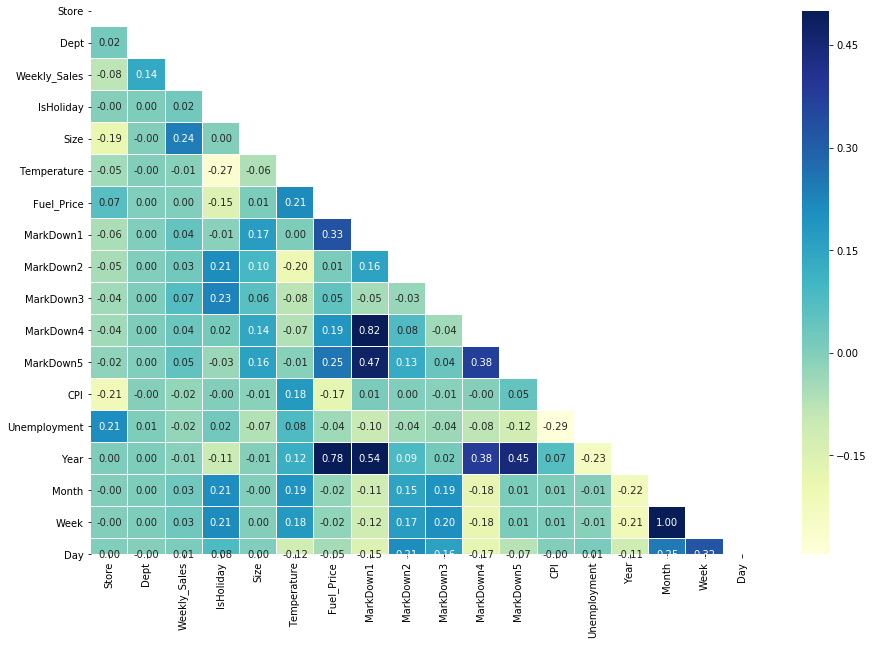

In [29]:
# Calculate correlations
corr = df.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
# Heatmap
plt.figure(figsize=(15, 10))
sns.heatmap(corr,
            vmax=.5,
            mask=mask,
            annot=True, fmt='.2f',
            linewidths=.2, cmap="YlGnBu")

In [30]:
df.shape

(88447, 20)

In [31]:
print("Number of Stores - ", df['Store'].nunique())
print("Number of Departments - ", df['Dept'].nunique())

Number of Stores -  45
Number of Departments -  81


In [32]:
#Count of each Store
df.Type.value_counts()

A    45271
B    34237
C     8939
Name: Type, dtype: int64

In [33]:
#Avergae size of each Type of Store
df.groupby('Type').describe()['Size'].round(2)

,count,mean,std,min,25%,50%,75%,max
Type,,,,,,,,
A,45271.0,182425.18,41556.70,39690.0,158114.0,202505.0,203819.0,219622.0
B,34237.0,101751.97,30898.47,34875.0,93188.0,114533.0,123737.0,140167.0
C,8939.0,40546.24,1199.57,39690.0,39690.0,39910.0,41062.0,42988.0


In [34]:
df1 = df.set_index('Date')

In [35]:
df1.head()

,Store,Dept,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Year,Month,Week,Day
Date,,,,,,,,,,,,,,,,,,,
2012-03-23,14,95,129326.88,False,A,200898,59.45,3.900,4718.70,348.81,6.85,353.11,3726.39,190.536321,8.424,2012,3,12,23
2011-06-10,30,8,11198.38,False,C,42988,84.71,3.648,0.00,0.00,0.00,0.00,0.00,214.696491,7.931,2011,6,23,10
2011-10-28,35,40,31195.27,False,B,103681,51.81,3.569,0.00,0.00,0.00,0.00,0.00,140.444790,8.745,2011,10,43,28
2010-06-18,43,12,113.56,False,C,41062,84.90,2.637,0.00,0.00,0.00,0.00,0.00,203.370619,9.593,2010,6,24,18
2012-06-01,9,2,28086.88,False,B,125833,80.26,3.501,2542.14,35.60,76.80,374.37,3413.57,225.494608,5.539,2012,6,22,1


In [36]:
y = df1['Weekly_Sales'].resample('MS').mean()

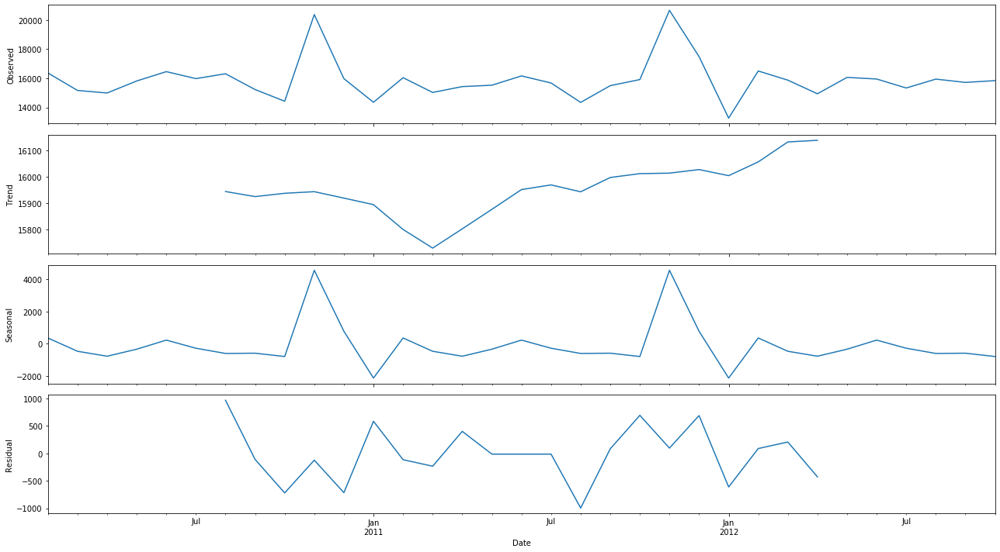

In [37]:
from pylab import rcParams
import statsmodels.api as sm
rcParams['figure.figsize'] = 18, 10
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

### Pie Chart for size of each Store type

In [38]:
#labels = ['Oxygen','Hydrogen','Carbon_Dioxide','Nitrogen']
#values = [4500, 2500, 1053, 500]

labels=['Store A','Store B','Store C']
sizes=df.describe()['Size'].round(1)
sizes=[(22/(17+6+22))*100,(17/(17+6+22))*100,(6/(17+6+22))*100] 

fig = go.Figure(data=[go.Pie(labels=labels, values=sizes)])

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent")

fig.update_layout(
    title_text="Store by sizes")

fig.show()

### Boxplot for Store Type Vs Size

In [39]:
import plotly.express as px
#ts = pd.concat([df['Type'], df['Size'])
fig = px.box(df, x = 'Type', y='Size', color='Type',
             title="Size of each type of store" 
            )
fig.show()

In [40]:
# By boxplot, we can infer that type A store is the largest store and C is the smallest
# Even more, there is no overlapped area in size among A, B, and C. Type is the best predictor for Size

In [41]:
#Department wise Sales
Dept_sales = df[df['IsHoliday'] == False].groupby(df.Dept)['Weekly_Sales'].mean()

In [42]:
#Department wise Holiday Sales
Dept_holiday_sales = df[df['IsHoliday'] == True].groupby(df.Dept)['Weekly_Sales'].mean()

### Boxplot for Weekly Sales Vs Type

In [43]:
ts = pd.concat([df.Type, df.Weekly_Sales], axis=1)
fig = px.box(ts, x = ts.Type, y=ts.Weekly_Sales, color=ts.Type,
             title="Weekly Sales of each type of store" 
            )
fig.show()

In [44]:
df['outlier'] = np.where((zscore(df['Weekly_Sales']) <= -2.5) | (zscore(df['Weekly_Sales']) >= 2.5), 1, 0)
num_outliers = df[df['outlier'] == 1]['Weekly_Sales'].count()

print('Number of `Weekly_Sales` outliers: {}\nPercent outliers: {:.2f}%'.format(num_outliers, num_outliers / df.shape[0] * 100))

Number of `Weekly_Sales` outliers: 2628
Percent outliers: 2.97%


In [45]:
qt = QuantileTransformer(output_distribution='normal')

In [46]:
df_copy=df.copy()

Text(0.5, 1.0, 'Weekly Sales')

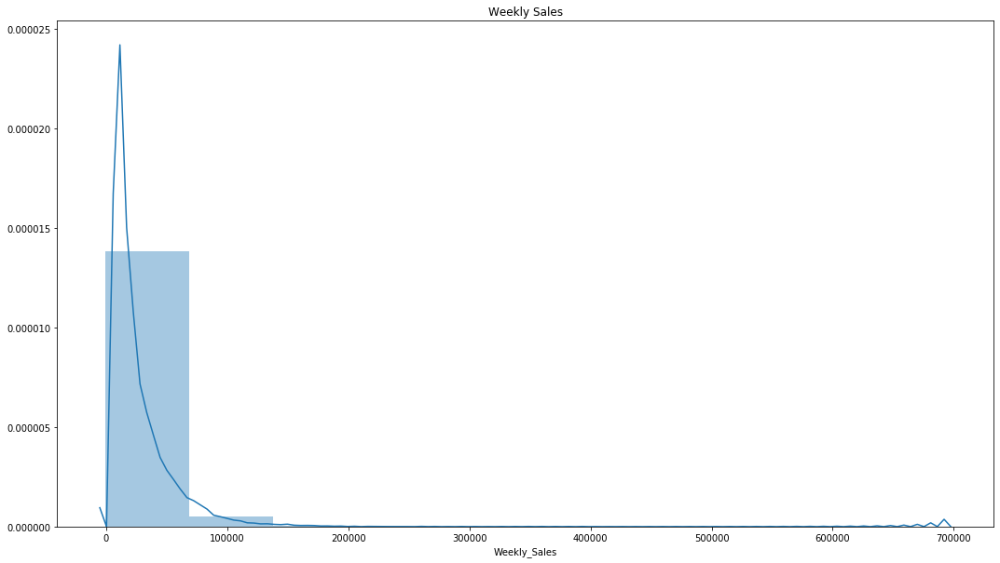

In [47]:
#Distribution plot is exponential for
sns.distplot(df_copy['Weekly_Sales'], bins=10).set_title('Weekly Sales')

In [48]:
df_copy['Weekly_Sales'] = qt.fit_transform(np.array(df_copy['Weekly_Sales'] + 1).reshape(-1, 1))

df_copy['outlier'] = np.where((zscore(df_copy['Weekly_Sales']) <= -2.5) | (zscore(df_copy['Weekly_Sales']) >= 2.5), 1, 0)
num_outliers = df_copy[df_copy['outlier'] == 1]['Weekly_Sales'].count()

print('QuantileTransformer - Number of `Weekly_Sales` outliers: {}\nPercent outliers: {:.2f}%'.format(num_outliers, num_outliers / df_copy.shape[0] * 100))

QuantileTransformer - Number of `Weekly_Sales` outliers: 1091
Percent outliers: 1.23%


In [49]:
# We conclude that the percent of outliers decreases from 3.26% to 1.18% so we need to apply transformation on our data

In [50]:
#Applying Quantile Transformer on original dataset
df['Weekly_Sales'] = qt.fit_transform(np.array(df['Weekly_Sales'] + 1).reshape(-1, 1))

Text(0.5, 1.0, '(1+Weekly Sales)\nQauntile Transformer\nno outliers')

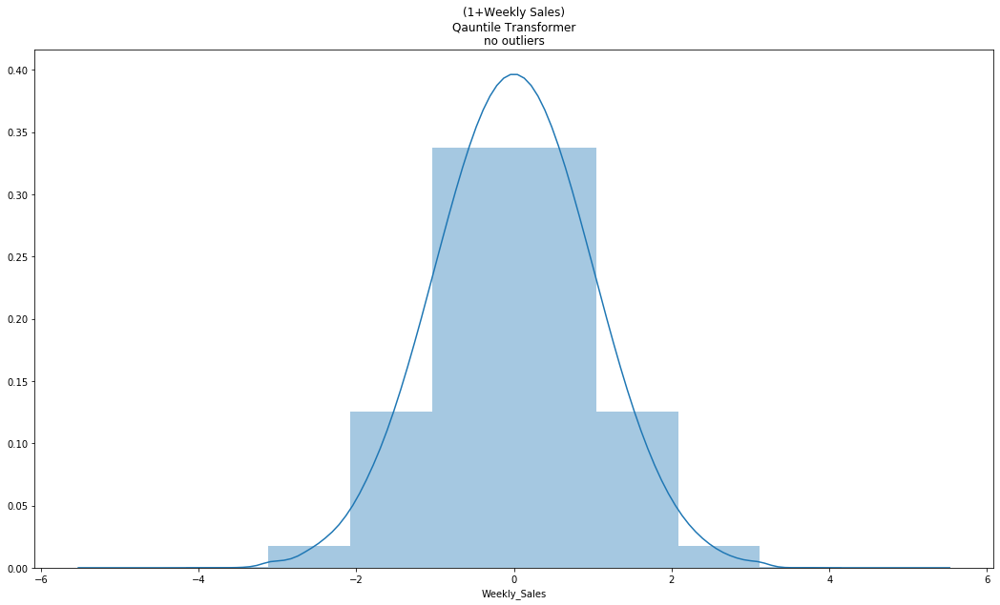

In [51]:
# Plotting after Transformation
sns.distplot(df['Weekly_Sales'], bins=10).set_title('(1+Weekly Sales)\nQauntile Transformer\nno outliers')

In [52]:
ts = pd.concat([df.Type, df.Weekly_Sales], axis=1)
fig = px.box(ts, x = ts.Type, y=ts.Weekly_Sales, color=ts.Type,
             title="Weekly Sales of each type of store" 
            )
fig.show()

In [53]:
# The median of A is the highest and C is the lowest.
# That means stores with more sizes have higher sales record because the order of median of size and median of sales
# is the same
# We observe that post transformation our data is less skewed 

In [54]:
fig = px.box(df, x = 'Month', y='Weekly_Sales', color='IsHoliday',
             title="Weekly Salse by Month" 
            )
fig.show()

In [55]:
fig = px.box(df, x = 'Dept', y='Weekly_Sales',
             title="Weekly Sales by Month" 
            ) # horizontal box plots
fig.show()

In [56]:
Dept_sales_pd = pd.DataFrame(Dept_sales).apply(lambda x: '%.5f' % x, axis=1).reset_index()
Dept_sales_pd.columns = ['Dept', 'Weekly_Sales']
Dept_holiday_sales_pd = pd.DataFrame(Dept_holiday_sales).apply(lambda x: '%.5f' % x, axis=1).reset_index()
Dept_holiday_sales_pd.columns = ['Dept', 'Weekly_Holiday_Sales']

In [57]:
Dept_sales.sort_values()

Dept
47        0.188440
43        1.000000
78        6.760000
39       13.906667
51       21.573545
          ...     
72    46873.348244
65    47228.881429
38    60935.888006
95    69219.117830
92    72665.699050
Name: Weekly_Sales, Length: 81, dtype: float64

In [58]:
#We found from the above analysis that department number 47 has negative Sales.
#We further drill down to see the negative weekly sales for this department.
df[df['Dept'] == 47]

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Year,Month,Week,Day,outlier
235,16,47,2012-05-11,-1.650019,False,B,57197,53.57,3.870,4814.92,0.00,61.11,343.64,837.48,197.548161,6.169,2012,5,19,11,0
295,3,47,2010-02-05,-2.147913,False,B,37392,45.71,2.572,0.00,0.00,0.00,0.00,0.00,214.424881,7.368,2010,2,5,5,0
437,34,47,2012-07-06,-3.150196,False,A,158114,77.95,3.187,6438.20,174.80,103.13,2529.03,3839.19,130.719633,9.285,2012,7,27,6,0
494,26,47,2010-05-21,-1.677780,False,A,152513,50.81,2.961,0.00,0.00,0.00,0.00,0.00,132.223032,8.512,2010,5,20,21,0
554,22,47,2012-06-15,-3.095319,False,B,119557,66.56,3.683,9564.70,193.90,9.06,3070.27,2588.53,142.129255,7.671,2012,6,24,15,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85305,40,47,2010-09-10,-3.217101,True,A,155083,62.75,2.717,0.00,0.00,0.00,0.00,0.00,132.756452,5.326,2010,9,36,10,0
85306,40,47,2012-02-10,-1.644653,True,A,155083,23.92,3.655,10333.24,3700.62,66.01,11804.09,7697.87,137.166677,4.261,2012,2,6,10,0
86010,41,47,2010-02-12,-1.602752,True,A,196321,23.04,2.572,0.00,0.00,0.00,0.00,0.00,189.464273,7.541,2010,2,6,12,0
88180,45,47,2011-02-11,-2.666071,True,B,118221,30.30,3.239,0.00,0.00,0.00,0.00,0.00,183.701613,8.549,2011,2,6,11,0


In [59]:
# Negative values need to be removed to be able to implement log transformation
df.loc[df['Weekly_Sales'] < 0.0,'Weekly_Sales'] = 0.0

#Department wise Sales
Dept_sales = df[df['IsHoliday'] == False].groupby(df.Dept)['Weekly_Sales'].mean()

#Department wise Holiday Sales
Dept_holiday_sales = df[df['IsHoliday'] == True].groupby(df.Dept)['Weekly_Sales'].mean()

Dept_sales_pd = pd.DataFrame(Dept_sales).apply(lambda x: '%.5f' % x, axis=1).reset_index()
Dept_sales_pd.columns = ['Dept', 'Weekly_Sales']
Dept_holiday_sales_pd = pd.DataFrame(Dept_holiday_sales).apply(lambda x: '%.5f' % x, axis=1).reset_index()
Dept_holiday_sales_pd.columns = ['Dept', 'Weekly_Holiday_Sales']

Dept_sales.sort_values()

Dept
99    0.000000
28    0.000000
37    0.000000
39    0.000000
43    0.000000
        ...   
40    1.249944
65    1.363815
38    1.580739
92    1.654447
95    1.661153
Name: Weekly_Sales, Length: 81, dtype: float64

In [60]:
Dept_holiday_sales.sort_values()

Dept
28    0.000000
85    0.000000
78    0.000000
77    0.000000
60    0.000000
        ...   
40    1.232614
38    1.507754
95    1.619450
72    1.677478
92    1.727126
Name: Weekly_Sales, Length: 81, dtype: float64

In [61]:
df_holidays = Dept_holiday_sales_pd.sort_values(by='Weekly_Holiday_Sales')

In [62]:
Dept_holiday_sales.sort_values().iplot(kind='bar', title='Holiday Sales by Department')
plt.show()

In [63]:
Dept_sales_pd = Dept_sales_pd.merge(Dept_holiday_sales_pd)

In [64]:
Dept_sales_pd.dtypes

Dept                     int64
Weekly_Sales            object
Weekly_Holiday_Sales    object
dtype: object

In [65]:
Dept_sales_pd = Dept_sales_pd.astype({'Weekly_Sales' : 'float', 'Weekly_Holiday_Sales' : 'float'})

In [66]:
Dept_sales_pd['Percent_Increase'] = ((Dept_sales_pd.Weekly_Holiday_Sales - Dept_sales_pd.Weekly_Sales)/ (Dept_sales_pd.Weekly_Sales))*100

In [67]:
# These departments show a significant change during holidays
Dept_sales_pd[Dept_sales_pd['Percent_Increase'] > 55]

,Dept,Weekly_Sales,Weekly_Holiday_Sales,Percent_Increase
5,6,0.02824,0.14988,430.736544
16,18,0.15804,0.32089,103.043533
22,24,0.06947,0.10936,57.420469
30,32,0.08029,0.12997,61.875701
31,33,0.06858,0.11020,60.688247
39,41,0.00956,0.01507,57.635983
42,44,0.01517,0.02758,81.806196
46,48,0.00000,0.00109,inf
48,50,0.00015,0.00148,886.666667
50,52,0.00007,0.00208,2871.428571


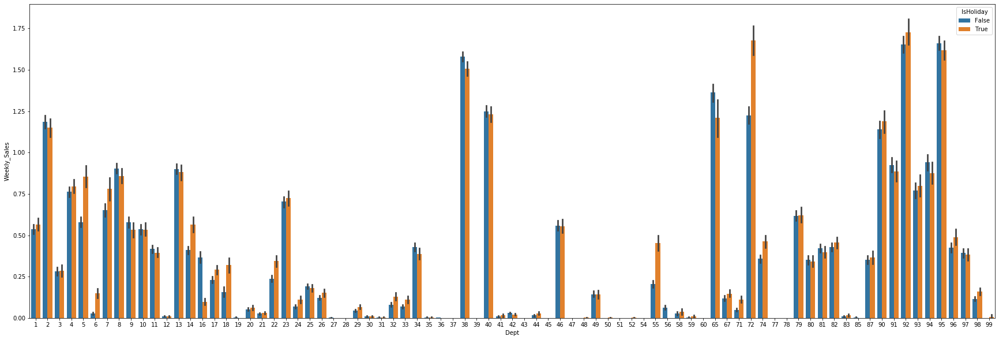

In [68]:
#Department wise sales comparison for holiday and no-holiday
data = pd.concat([df.Dept, df.Weekly_Sales, df.IsHoliday], axis=1)
f, ax = plt.subplots(figsize=(30, 10))
fig = sns.barplot(x='Dept', y="Weekly_Sales", data=data, hue='IsHoliday')

In [69]:
#Converting holiday to binary values
df['IsHoliday'] = df['IsHoliday'].apply(lambda x: 1 if x==True else 0)

In [70]:
#Applying one hot encoding on Type
df = pd.get_dummies(df, columns=['Type'])

In [71]:
df.drop(columns=['Date', "CPI", "Fuel_Price", 'Unemployment', 'MarkDown4', 'Type_A', 'outlier'], inplace=True)

In [72]:
#Replacing Negative Values of MarkDown by 0
df.loc[df['MarkDown1'] < 0.0,'MarkDown1'] = 0.0
df.loc[df['MarkDown2'] < 0.0,'MarkDown2'] = 0.0
df.loc[df['MarkDown3'] < 0.0,'MarkDown3'] = 0.0
#df.loc[df['MarkDown4'] < 0.0,'MarkDown4'] = 0.0
df.loc[df['MarkDown5'] < 0.0,'MarkDown5'] = 0.0

In [73]:
df.head()

,Store,Dept,Weekly_Sales,IsHoliday,Size,Temperature,MarkDown1,MarkDown2,MarkDown3,MarkDown5,Year,Month,Week,Day,Type_B,Type_C
0,14,95,2.532763,0,200898,59.45,4718.70,348.81,6.85,3726.39,2012,3,12,23,0,0
1,30,8,0.236995,0,42988,84.71,0.00,0.00,0.00,0.00,2011,6,23,10,0,1
2,35,40,1.000325,0,103681,51.81,0.00,0.00,0.00,0.00,2011,10,43,28,1,0
3,43,12,0.000000,0,41062,84.90,0.00,0.00,0.00,0.00,2010,6,24,18,0,1
4,9,2,0.919698,0,125833,80.26,2542.14,35.60,76.80,3413.57,2012,6,22,1,1,0


## Applying feature engineering on test data

In [74]:
test = test.merge(stores, how='left').merge(features, how='left')
print('Columns with null values:' ,sum(list(test.isnull().any())))

Columns with null values: 6


In [75]:
test.isnull().any()

Store           False
Dept            False
Date            False
IsHoliday       False
Type            False
Size            False
Temperature     False
Fuel_Price      False
MarkDown1        True
MarkDown2        True
MarkDown3        True
MarkDown4        True
MarkDown5       False
CPI              True
Unemployment     True
dtype: bool

In [76]:
test.fillna(0,inplace=True)

In [77]:
test.Date = pd.to_datetime(test.Date)
test['Year'] = test.Date.dt.year
test['Month'] = test.Date.dt.month
test['Week'] = test.Date.dt.week
test['Day'] = test.Date.dt.day
#test['no_days'] = (test.Date.dt.date - test.Date.dt.date.min()).apply(lambda x:x.days)

In [78]:
test = pd.get_dummies(test, columns=['Type'])

In [79]:
#Converting holiday to binary values
test['IsHoliday'] = test['IsHoliday'].apply(lambda x: 1 if x==True else 0)

In [80]:
test.loc[test['MarkDown1'] < 0.0,'MarkDown1'] = 0.0
test.loc[test['MarkDown2'] < 0.0,'MarkDown2'] = 0.0
test.loc[test['MarkDown3'] < 0.0,'MarkDown3'] = 0.0
test.loc[test['MarkDown4'] < 0.0,'MarkDown4'] = 0.0
test.loc[test['MarkDown5'] < 0.0,'MarkDown5'] = 0.0

In [81]:
date = test.Date

In [82]:
test.drop(["Date", "CPI", "Fuel_Price", 'Unemployment', 'MarkDown4', 'Type_A'], axis=1, inplace=True)

In [83]:
test.head()

,Store,Dept,IsHoliday,Size,Temperature,MarkDown1,MarkDown2,MarkDown3,MarkDown5,Year,Month,Week,Day,Type_B,Type_C
0,1,1,0,151315,55.32,6766.44,5147.70,50.82,2737.42,2012,11,44,2,0,0
1,1,1,0,151315,61.24,11421.32,3370.89,40.28,6154.16,2012,11,45,9,0,0
2,1,1,0,151315,52.92,9696.28,292.10,103.78,6612.69,2012,11,46,16,0,0
3,1,1,1,151315,56.23,883.59,4.17,74910.32,303.32,2012,11,47,23,0,0
4,1,1,0,151315,52.34,2460.03,0.00,3838.35,6966.34,2012,11,48,30,0,0


# Model Creation

In [84]:
df_2y = df[df['Year'] != 2012 ]
df_2012 = df[df['Year'] == 2012 ]
X_train = df_2y.drop('Weekly_Sales', axis=1)
y_train = df_2y['Weekly_Sales']
X_valid = df_2012.drop('Weekly_Sales', axis=1)
y_valid = df_2012['Weekly_Sales']

In [85]:
from sklearn.pipeline import Pipeline, FeatureUnion, make_pipeline
from sklearn import preprocessing
scaler = StandardScaler()

In [86]:
scaler.fit(X_train)

StandardScaler(copy=True, with_mean=True, with_std=True)

In [87]:
X_train_std = scaler.transform(X_train)  
X_valid_std = scaler.transform(X_valid) 
X_train = pd.DataFrame(X_train_std, index = X_train.index, columns = X_train.columns)
X_valid = pd.DataFrame(X_valid_std, index = X_valid.index, columns = X_valid.columns)

# KNN

In [88]:
import time
start = time.time()
knn = KNeighborsRegressor()
knn.fit(X_train, y_train)
end = time.time()
time_elapsed = end - start
time_elapsed

7.431063890457153

In [89]:
def weighted_mae_custom(y_true, y_pred):
    '''
    Custom weighting function as specified in the evaluation section.
    '''
    weights = X_valid['IsHoliday']
    sample_weights = pd.Series(weights.loc[y_true.index.values].values.reshape(-1)).dropna()
    return (1.0 / np.sum(sample_weights)) * np.sum(sample_weights * np.abs(y_true - y_pred))

weighted_mae = make_scorer(weighted_mae_custom)

In [90]:
weighted_mae(knn, X_valid, y_valid)

0.10985974798710438

In [91]:
def weighted_mae_custom(y_true, y_pred):
    '''
    Custom weighting function as specified in the evaluation section.
    '''
    weights = X_train['IsHoliday']
    sample_weights = pd.Series(weights.loc[y_true.index.values].values.reshape(-1)).dropna()
    return (1.0 / np.sum(sample_weights)) * np.sum(sample_weights * np.abs(y_true - y_pred))

weighted_mae1 = make_scorer(weighted_mae_custom)

In [92]:
params = {'n_neighbors': [2, 3, 4], 'p': [1,2]}
with parallel_backend('dask'):
    gs_cv = GridSearchCV(knn, 
                         param_grid = params,
                         cv=3,
                         scoring=weighted_mae1,
                         n_jobs=-1,
                         iid=True,
                         verbose=2).fit(X_train, y_train)

Fitting 3 folds for each of 6 candidates, totalling 18 fits


[Parallel(n_jobs=-1)]: Using backend DaskDistributedBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 out of  18 | elapsed:  1.4min finished


In [93]:
gs_cv.best_params_

{'n_neighbors': 3, 'p': 2}

In [94]:
weighted_mae(gs_cv, X_valid, y_valid)

0.11552413599689185

# Support Vector Machine

In [95]:
start = time.time()
clf = svm.SVR()
svm_pipeline = make_pipeline(scaler, clf)
with parallel_backend('dask'):
    svm_pipeline.fit(X_train, y_train)
end = time.time()
time_elapsed = end - start
time_elapsed

180.56355595588684

In [96]:
weighted_mae(clf, X_valid, y_valid)

0.13410956504371263

In [97]:
param_grid = {'gamma' : [1, 0.1, 0.001],
              'C' : [0.25,0.5,1]}
grid = GridSearchCV(svm_pipeline[1], 
                    param_grid,
                    cv=3,
                    scoring=weighted_mae1,
                    n_jobs=-1,
                    iid=True,
                    verbose=2)
with parallel_backend('dask'):
    grid.fit(X_train, y_train)

Fitting 3 folds for each of 9 candidates, totalling 27 fits


[Parallel(n_jobs=-1)]: Using backend DaskDistributedBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  27 out of  27 | elapsed: 24.9min finished


In [98]:
grid.best_params_

{'C': 0.25, 'gamma': 0.001}

In [99]:
weighted_mae(grid, X_valid, y_valid)

0.1096641019530232

# Random Forest

In [100]:
start = time.time()
rf = RandomForestRegressor()
rf.fit(X_train, y_train)
end = time.time()
time_elapsed = end - start
time_elapsed

2.3136260509490967

In [101]:
weighted_mae(rf, X_valid, y_valid)

0.017314368981879748

In [102]:
feature_imp = pd.DataFrame(rf.feature_importances_, index=X_train.columns, 
columns=['importance']).sort_values('importance', ascending=False)
feature_imp

,importance
Dept,0.638809
Size,0.209331
Store,0.055198
Week,0.034117
Temperature,0.017578
Type_B,0.014212
Day,0.010701
MarkDown3,0.005393
Month,0.004716
Type_C,0.002598


In [103]:
params = {'n_estimators': [100,250,500], 
          'max_features' : ['log2','auto','sqrt']}
gs_rf = GridSearchCV(rf,
                         param_grid = params,
                         cv=3,
                         scoring=weighted_mae1,
                         n_jobs=-1,
                         iid=True,
                         verbose=2).fit(X_train, y_train)

Fitting 3 folds for each of 9 candidates, totalling 27 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  27 out of  27 | elapsed:  5.4min finished


In [104]:
df_results = pd.DataFrame(gs_rf.cv_results_)

In [105]:
df_results.pivot(index='param_n_estimators',
                 columns='param_max_features',
                 values='mean_test_score').round(3).style.background_gradient('coolwarm', axis=None)

param_max_features,auto,log2,sqrt
param_n_estimators,,,
100,0.013,0.053,0.054
250,0.013,0.053,0.053
500,0.013,0.053,0.054


In [106]:
gs_rf.best_params_

{'max_features': 'sqrt', 'n_estimators': 100}

In [107]:
weighted_mae(gs_rf, X_valid, y_valid)

0.06414747873680231

In [108]:
n_estimators=gs_rf.best_params_['n_estimators']
max_features=gs_rf.best_params_['max_features']
rf1 = RandomForestRegressor(n_estimators=n_estimators, max_features=max_features)
rf1.fit(X_train, y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='sqrt', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)

In [109]:
feature_imp = pd.DataFrame(rf1.feature_importances_, index=X_train.columns, 
columns=['importance']).sort_values('importance', ascending=False)
feature_imp

,importance
Dept,0.710803
Size,0.083765
Store,0.045576
Temperature,0.042725
Week,0.026536
Day,0.025651
Type_B,0.019052
Month,0.014387
MarkDown3,0.006681
Type_C,0.005037


In [110]:
test['Weekly_Sales'] = qt.inverse_transform(gs_rf.predict(test).reshape(-1, 1)) + 1

In [111]:
test['Date'] = date

In [112]:
test.head()

,Store,Dept,IsHoliday,Size,Temperature,MarkDown1,MarkDown2,MarkDown3,MarkDown5,Year,Month,Week,Day,Type_B,Type_C,Weekly_Sales,Date
0,1,1,0,151315,55.32,6766.44,5147.70,50.82,2737.42,2012,11,44,2,0,0,34805.794368,2012-11-02
1,1,1,0,151315,61.24,11421.32,3370.89,40.28,6154.16,2012,11,45,9,0,0,34805.794368,2012-11-09
2,1,1,0,151315,52.92,9696.28,292.10,103.78,6612.69,2012,11,46,16,0,0,34805.794368,2012-11-16
3,1,1,1,151315,56.23,883.59,4.17,74910.32,303.32,2012,11,47,23,0,0,32993.303080,2012-11-23
4,1,1,0,151315,52.34,2460.03,0.00,3838.35,6966.34,2012,11,48,30,0,0,29534.269140,2012-11-30


In [113]:
from sklearn.externals import joblib

joblib.dump(test, 'rf_test.pkl')

['rf_test.pkl']

# Linear Regression

In [114]:
import time
start = time.time()
lr = LinearRegression()
lr.fit(X_train, y_train)
end = time.time()
time_elapsed = end - start
time_elapsed

0.0804443359375

In [115]:
weighted_mae(lr, X_valid, y_valid)

0.12186575516212889

In [116]:
myarray = np.asarray(lr.coef_)
coefficient_imp = pd.DataFrame(list(zip(X_train.columns, myarray)),
            columns = ['column', 'Coefficients']).sort_values('Coefficients', ascending=False)
coefficient_imp['Coefficients'] = coefficient_imp['Coefficients'].apply(lambda x: '{:.2f}'.format(x))
coefficient_imp

,column,Coefficients
11,Week,1.68
3,Size,0.16
1,Dept,0.07
14,Type_C,0.05
7,MarkDown3,0.03
5,MarkDown1,0.01
8,MarkDown5,0.01
4,Temperature,0.00
13,Type_B,0.00
6,MarkDown2,-0.00


In [117]:
params = {'fit_intercept':[True,False], 'normalize':[True,False], 'copy_X':[True, False]}

In [118]:
gs_lr = GridSearchCV(lr,
                    param_grid = params,
                    cv=3,
                    scoring=weighted_mae1,
                    n_jobs=-1,
                    iid=True,
                    verbose=2)
gs_lr.fit(X_train,y_train)

Fitting 3 folds for each of 8 candidates, totalling 24 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  24 out of  24 | elapsed:    0.7s finished


GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=LinearRegression(copy_X=True, fit_intercept=True,
                                        n_jobs=None, normalize=False),
             iid=True, n_jobs=-1,
             param_grid={'copy_X': [True, False],
                         'fit_intercept': [True, False],
                         'normalize': [True, False]},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=make_scorer(weighted_mae_custom), verbose=2)

In [119]:
gs_lr.best_params_

{'copy_X': True, 'fit_intercept': False, 'normalize': True}

In [120]:
fit_intercept = gs_lr.best_params_['fit_intercept']
normalize=gs_lr.best_params_['normalize']
copy_X=gs_lr.best_params_['copy_X']
lr1=LinearRegression(fit_intercept=fit_intercept, normalize=normalize, copy_X=copy_X)
lr1.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=True)

In [121]:
weighted_mae(lr1, X_valid, y_valid)

0.12208842183150852

In [122]:
myarray = np.asarray(lr1.coef_)
coefficient_imp = pd.DataFrame(list(zip(X_train.columns, myarray)),
            columns = ['column', 'Coefficients']).sort_values('Coefficients', ascending=False)
coefficient_imp['Coefficients'] = coefficient_imp['Coefficients'].apply(lambda x: '{:.2f}'.format(x))
coefficient_imp

,column,Coefficients
11,Week,1.68
3,Size,0.16
1,Dept,0.07
14,Type_C,0.05
7,MarkDown3,0.03
5,MarkDown1,0.01
8,MarkDown5,0.01
4,Temperature,0.00
13,Type_B,0.00
6,MarkDown2,-0.00


In [123]:
fig = go.Figure(data=[
    go.Bar(name='LR', x=X_train.columns, y=coefficient_imp.Coefficients),
    go.Bar(name='RF', x=X_train.columns, y=feature_imp.importance)
])
# Change the bar mode
fig.update_layout(barmode='group')
fig.update_layout(
    title_text="Feature Comparison between Linear Regression and Random Forest")
fig.show()

In [124]:
name = ['K Nearest Neighbor', 'Support Vector Machine', 'Random Forest', 'Linear Regression']
time = [8.8, 180.31, 2.62, 0.039]
gs_time = [300, 1507, 306, 0.8]
wmae = [0.1093, 0.1096, 0.064, 0.122]

In [125]:
result_df = pd.DataFrame(list(zip(name, time, gs_time, wmae)), 
               columns =['Model', 'Initial model Time (secs)', 'Grid search time (secs)', 'WMAE'])
result_df.head()

,Model,Initial model Time (secs),Grid search time (secs),WMAE
0,K Nearest Neighbor,8.800,300.0,0.1093
1,Support Vector Machine,180.310,1507.0,0.1096
2,Random Forest,2.620,306.0,0.0640
3,Linear Regression,0.039,0.8,0.1220


In [126]:
fig = px.bar(result_df, x='Model', y='Grid search time (secs)', color='WMAE', height=400)
fig.update_layout(
    title_text="Overall Model Comaprison")
fig.show()